# [Particle Swarm Optimization](https://en.wikipedia.org/wiki/Particle_swarm_optimization)

PSO (Particle Swarm Optimization) is a *computational optimization* technique **inspired by the social behavior of bird flocks and fish schools**.

It's a population-based **evolutionary algorithm** that's particularly useful for solving complex optimization problems.

In [3]:
import sys
from pathlib import Path
from IPython.display import display

doc_dir = Path().absolute().parent  # This points to the doc/ directory
if str(doc_dir) not in sys.path:
    sys.path.insert(0, str(doc_dir))

from init_notebook import PSO, np

Added c:\Users\fire\Lab\ai to Python path
Set random seeds to 42


In [4]:
# Define a test function (Rastrigin function - a common benchmark for optimization)
def rastrigin(x):
    """
    Rastrigin function. Has many local minima.
    Global minimum at x = 0 where f(x) = 0.
    """
    n = len(x)
    return 10 * n + sum([(xi**2 - 10 * np.cos(2 * np.pi * xi)) for xi in x])

Particle Swarm Optimization

Optimizing Rastrigin function in 2D with 30 particles
Iteration 1: Best fitness = 5.9846, Avg fitness = 28.5770
Iteration 11: Best fitness = 0.1098, Avg fitness = 18.9172
Iteration 21: Best fitness = 0.0023, Avg fitness = 7.5320
Iteration 31: Best fitness = 0.0000, Avg fitness = 5.5459
Iteration 41: Best fitness = 0.0000, Avg fitness = 1.8434
Iteration 51: Best fitness = 0.0000, Avg fitness = 1.1925
Iteration 61: Best fitness = 0.0000, Avg fitness = 0.8076
Iteration 71: Best fitness = 0.0000, Avg fitness = 0.2452
Iteration 81: Best fitness = 0.0000, Avg fitness = 0.0010
Iteration 91: Best fitness = 0.0000, Avg fitness = 0.0000
Iteration 100: Best fitness = 0.0000, Avg fitness = 0.0000

Optimization Results:
Best position: [1.93789203e-10 1.35281927e-09]
Best fitness: 0.000000


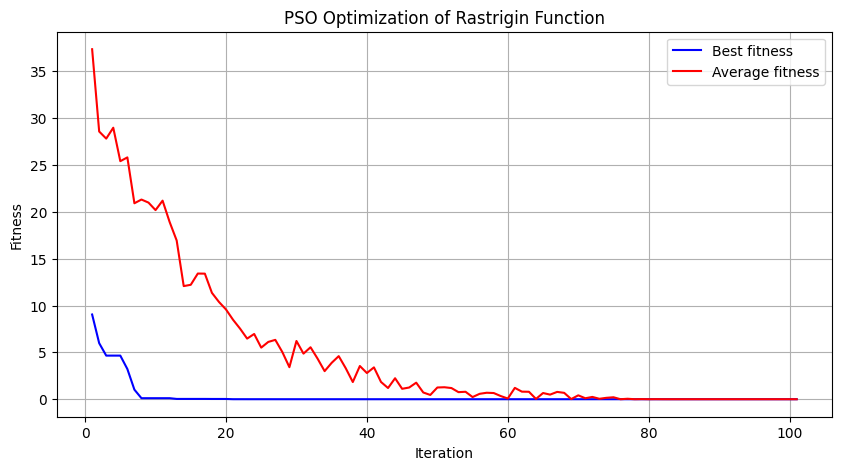

In [5]:
num_particles = 30
dimensions = 2
bounds = (-5.12, 5.12)  # Standard bounds for Rastrigin function
max_iterations = 100

# Initialize and run PSO
pso = PSO(
    num_particles=num_particles,
    dimensions=dimensions,
    fitness_function=rastrigin,
    bounds=bounds,
    w=0.5,  # Inertia weight
    c1=1.5,  # Cognitive weight
    c2=1.5,  # Social weight
    max_iterations=max_iterations,
    minimize=True,  # We want to minimize the Rastrigin function
)

print("\033[92mParticle Swarm Optimization\033[0m\n")
print(f"Optimizing Rastrigin function in {dimensions}D with {num_particles} particles")

# Optimize
best_position, best_fitness = pso.optimize()

# Print results
print("\nOptimization Results:")
print(f"Best position: {best_position}")
print(f"Best fitness: {best_fitness:.6f}")

# Plot fitness history
pso.plot_history(title="PSO Optimization of Rastrigin Function")

In [6]:
def visualize_pso_in_notebook(pso_instance, interval=100):
    """
    Create an interactive animation of PSO particles moving in 2D space
    that works properly in Jupyter notebooks.

    Args:
        pso_instance: An instance of the PSO class
        interval: Time interval between frames in milliseconds

    Returns:
        IPython HTML object containing the animation
    """
    from IPython.display import HTML
    import matplotlib.pyplot as plt
    from matplotlib.animation import FuncAnimation

    if pso_instance.dimensions != 2:
        print("Visualization only available for 2D problems.")
        return

    # Create figure and axis
    fig, ax = plt.subplots(figsize=(10, 8))

    # Create a contour plot of the fitness function
    x = np.linspace(pso_instance.bounds[0], pso_instance.bounds[1], 100)
    y = np.linspace(pso_instance.bounds[0], pso_instance.bounds[1], 100)
    X, Y = np.meshgrid(x, y)
    Z = np.zeros_like(X)

    for i in range(X.shape[0]):
        for j in range(X.shape[1]):
            Z[i, j] = pso_instance.fitness_function(np.array([X[i, j], Y[i, j]]))

    contour = ax.contourf(X, Y, Z, 50, cmap="viridis", alpha=0.6)
    plt.colorbar(contour, ax=ax)

    # Plot the global optimum
    ax.scatter(
        pso_instance.global_best_position[0],
        pso_instance.global_best_position[1],
        c="red",
        marker="*",
        s=200,
        label="Global Best",
    )

    # Initialize particle scatter plot
    particles_scatter = ax.scatter([], [], c="white", edgecolors="black", s=50)

    # Set plot boundaries and labels
    ax.set_xlim(pso_instance.bounds[0], pso_instance.bounds[1])
    ax.set_ylim(pso_instance.bounds[0], pso_instance.bounds[1])
    ax.set_title("Particle Swarm Optimization")
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.grid(True)
    ax.legend()

    # Animation update function
    def update(frame):
        particles_scatter.set_offsets(pso_instance.positions_history[frame])
        ax.set_title(f"Particle Swarm Optimization - Iteration {frame}")
        return (particles_scatter,)

    # Create animation
    animation = FuncAnimation(
        fig,
        update,
        frames=len(pso_instance.positions_history),
        interval=interval,
        blit=True,
    )

    # Close the static figure to prevent it from displaying
    plt.close(fig)

    # Return HTML animation that works in Jupyter
    return HTML(animation.to_jshtml())

In [7]:
if dimensions == 2:
    animation = visualize_pso_in_notebook(pso, interval=100)
    display(animation)

Animation size has reached 21062504 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
